In [2]:
import os
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
import numpy as np

import matplotlib as mlp

['0.00-0.20', '0.20-0.40', '0.00-0.20', '0.40-0.60', '0.60-0.80', '0.80-1.00', '0.60-0.80', '0.00-0.20', '0.80-1.00', '0.20-0.40', '0.20-0.40', '0.40-0.60', '0.00-0.20', '0.00-0.20', '0.60-0.80', '0.40-0.60', '0.00-0.20', '0.00-0.20', '0.20-0.40', '0.00-0.20', '0.20-0.40', '0.00-0.20', '0.00-0.20', '0.80-1.00', '0.80-1.00', '0.00-0.20', '0.60-0.80', '0.20-0.40', '0.80-1.00', '0.00-0.20', '0.00-0.20', '0.80-1.00', '0.40-0.60', '0.00-0.20', '0.00-0.20', '0.60-0.80', '0.20-0.40', '0.20-0.40', '0.00-0.20', '0.20-0.40', '0.60-0.80', '0.20-0.40', '0.00-0.20', '0.20-0.40', '0.40-0.60', '0.00-0.20', '0.80-1.00', '0.80-1.00', '0.40-0.60', '0.00-0.20', '0.20-0.40', '0.00-0.20', '0.00-0.20', '0.00-0.20', '0.20-0.40', '0.60-0.80', '0.80-1.00', '0.80-1.00', '0.20-0.40', '0.00-0.20', '0.00-0.20', '0.00-0.20', '0.00-0.20', '0.00-0.20', '0.20-0.40', '0.20-0.40', '0.00-0.20', '0.00-0.20', '0.60-0.80', '0.20-0.40', '0.00-0.20', '0.20-0.40', '0.80-1.00', '0.80-1.00', '0.40-0.60', '0.40-0.60', '0.00-0.20'

/tmp/ipykernel_9000/1791449095.py:154: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


'\nfigure = plt.figure(figsize=(15,12),dpi=250)\ngs = mlp.gridspec.GridSpec(2,2,wspace=0.05,hspace=0.05)\nfrom PIL import Image\n\nvis = Image.open(\'../Withoutb1ia.png\')\n\nax=figure.add_subplot(gs[0,0])\nax.imshow(vis, interpolation=None)\nax.set_title(r"$\x08f{" + "a" + "}$",x=-0.)\nax.axis(\'off\')\nvis = Image.open(\'../Withb1ia.png\')\n\nax=figure.add_subplot(gs[0,1])\nax.imshow(vis, interpolation=None)\nax.set_title(r"$\x08f{" + "b" + "}$",x=-0.)\nax.axis(\'off\')\n\nax=figure.add_subplot(gs[1,0])\nax.set_title(r"$\x08f{" + "c" + "}$",x=-0.115,y=0.95)\nax.text(-0.25,1.15,r"$\x08f{" + "Inside" + "}$")\nax.pie(classes_count_in,colors=palette,autopct=\'%.0f%%\',labels=order,startangle=0)\n\nax =figure.add_subplot(gs[1,1])\nax.set_title(r"$\x08f{" + "d" + "}$",x=-0.115,y=0.95)\nax.text(-0.25,1.15,r"$\x08f{" + "Outside" + "}$")\nax.pie(classes_count_out,colors=palette,autopct=\'%.0f%%\',labels=order,startangle=0)\nplt.tight_layout()\nplt.savefig(\'InOutia.eps\',bbox_inches=\'tight\'

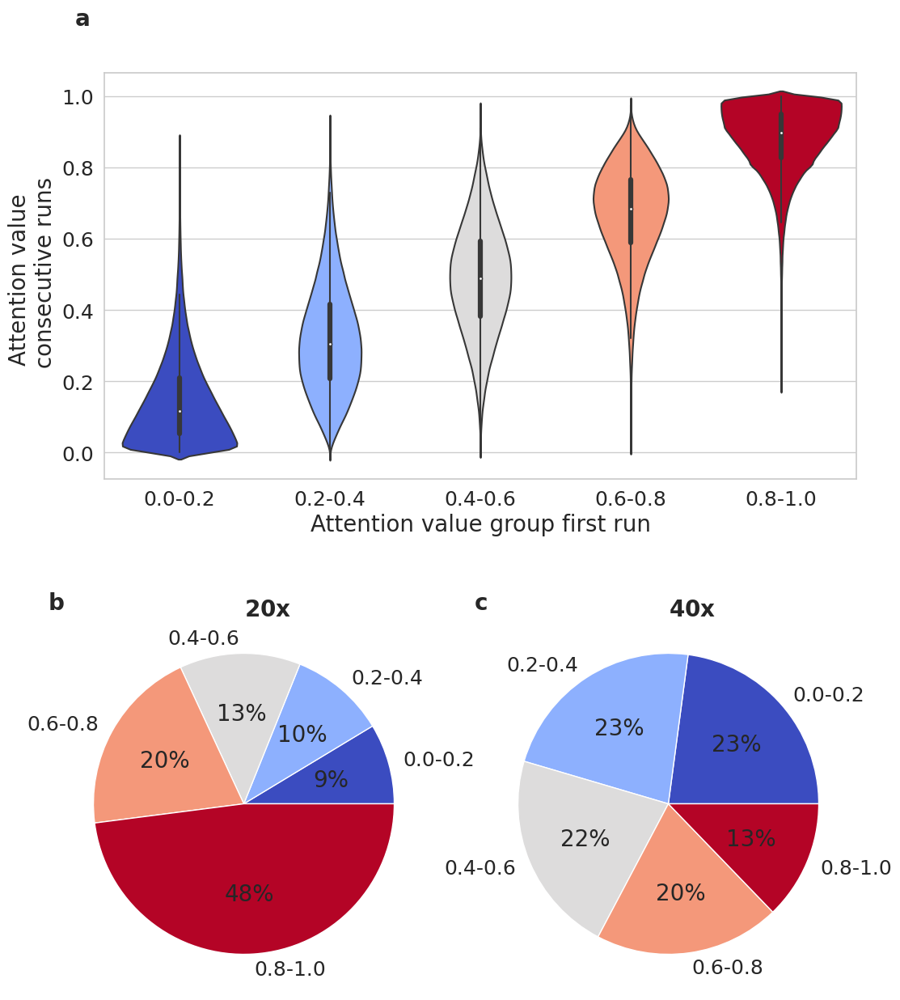

In [26]:
def convert_with_zeros(bnum):
    
    number = bnum.split('B')[1]
    parts = number.split('-')

    return 'B' + '0' * (6-len(str(parts[0]))) + str(int(parts[0])) + '-' + parts[1]
import numpy as np
import os

model = 'b1b2'#'b1ia'
For = 'A'#'A/'
folder_res = './results/'+For+'_StanzeNarrow_'+model+'/'
files_res = [f for f in os.listdir(folder_res) if f.endswith('.npy')]

classes = []
values = []
groups = 6

sub = 'attn/'

folder_40 ='./results/'+For+'_StanzeNarrow_'+model+'/40/'+sub
files_40 = os.listdir(folder_40)

folder_20 ='./results/'+For+'_StanzeNarrow_'+model+'/20/'+sub
files_20 = os.listdir(folder_20)


sub = 'int_r/'#'attn/'
folder_40_in ='./results/'+For+'_StanzeNarrow_'+model+'/40/'+sub
files_40_in = os.listdir(folder_40_in)

folder_20_in ='./results/'+For+'_StanzeNarrow_'+model+'/20/'+sub
files_20_in = os.listdir(folder_20_in)

sub = 'out_r/'
folder_40_out ='./results/'+For+'_StanzeNarrow_'+model+'/40/'+sub
files_40_out = os.listdir(folder_40_out)

folder_20_out ='./results/'+For+'_StanzeNarrow_'+model+'/20/'+sub
files_20_out = os.listdir(folder_20_out)

b = np.linspace(0.0,1,groups)
def get_scores(files, folder,ref_folder,groups,classes,values,use_ref=False):
    classes_count = [0 for i in range(groups-1)]
    b = np.linspace(0.0,1,groups)
    for i in range(len(files)):
        a = np.load(folder+files[i])

        bnum = convert_with_zeros(files[i].split('-')[0] + '-' + files[i].split('-')[1])
        ignore = ["B001767-20","B000049-20","B000495-20","B000174-21"]
        if bnum in ignore:
            continue

        a_ref = np.load(ref_folder+files[i])
        for j in range(len(a)):
            done = False
            for r in range(len(a[j])):
                a_k = 0
                for k in range(1, len(b)):
                    if a[j][r] <= b[k]:
                        discrete = (k-1)/(groups-1)
                        a_k = k-1
                        break
                if use_ref:
                    classes_count[a_k] += 1./(len(a)+len(a_ref))
                else:
                    classes_count[a_k] += 1./len(a)

                for r2 in range(len(a[j])):
                    if r2 == r:
                        continue
                    if done:
                        break

                    classes.append("{:.2f}".format(discrete)+'-'+"{:.2f}".format(discrete+(1./(groups-1))))
                    values.append(a[j][r2])
                    done = True


    return classes_count, classes, values


import seaborn as sns
from matplotlib import pyplot as plt
import seaborn as sns
sns.set_theme(style='whitegrid')
plt.rc('font', size=20) 

plt.rc('axes', titlesize=20) 
plt.rc('axes', labelsize=20) 
plt.rc('xtick', labelsize=18) 
plt.rc('ytick', labelsize=18) 
order = ["{:.1f}".format(i/(groups-1))+'-'+"{:.1f}".format(i/(groups-1)+(1./(groups-1))) for i in range(len(b)-1)]
cmap = plt.get_cmap('coolwarm')
palette = [cmap(v) for v in (np.linspace(0,1,groups-1))]
figure = plt.figure(figsize=(12,15))
gs = mlp.gridspec.GridSpec(2,2,wspace=0.0,hspace=0.3)
if True:
    class_count_40 = [0 for i in range(groups-1)]
    class_count_20 = [0 for i in range(groups-1)]

    class_count_40,classes,values = get_scores(files_40, folder_40,folder_20,groups,classes,values,use_ref=False)
    class_count_20,classes,values = get_scores(files_20, folder_20,folder_40,groups,classes,values,use_ref=False)
    """
    classes_count_in = [0 for i in range(groups-1)]

    class_count_40_in,_,_ = get_scores(files_40_in,folder_40_in,folder_20_in,groups,[],[],use_ref=True)
    class_count_20_in,_,_ = get_scores(files_20_in,folder_20_in,folder_40_in,groups,[],[],use_ref=False)
    #classes_count_in = [classes_count_in[i]+class_count_40_in[i] for i in range(len(classes_count_in))]
    classes_count_in = [classes_count_in[i]+class_count_20_in[i] for i in range(len(classes_count_in))]


    classes_count_out = [0 for i in range(groups-1)]

    class_count_40_out,_,_ = get_scores(files_40_out,folder_40_out,folder_20_out,groups,[],[],use_ref=True)
    class_count_20_out,_,_ = get_scores(files_20_out,folder_20_out,folder_40_out,groups,[],[],use_ref=False)
    #classes_count_out = [classes_count_out[i]+class_count_40_out[i] for i in range(len(classes_count_out))]
    classes_count_out = [classes_count_out[i]+class_count_20_out[i] for i in range(len(classes_count_out))]
    """

    np.save('classes1.npy',np.array(classes))
    np.save('values1.npy',np.array(values))
    np.save('c201.npy',np.array(class_count_20))
    np.save('c401.npy',np.array(class_count_40))
else:
    classes = np.load('classes1.npy')
    values= np.load('values1.npy')
    class_count_20 = np.load('c201.npy')
    class_count_40 = np.load('c401.npy')
figure.add_subplot(gs[0,:])
print(classes)
classes = [c[0:3]+c[4:-1] for c in classes]
print(classes)
ax = sns.violinplot(x=classes,y=values,order=order,palette=palette,saturation=1)
ax.set_yticks(np.linspace(0,1,groups))
ax.set_xlabel("Attention value group first run")
ax.set_ylabel("Attention value \n consecutive runs")
ax.set_title(r"$\bf{" + "a" + "}$",x=-0.03,y=1.1)

ax=figure.add_subplot(gs[1,0])
box = ax.get_position()
box.x0 = box.x0 - 0.05
box.x1 = box.x1 - 0.05
ax.set_position(box)
ax.set_title(r"$\bf{" + "b" + "}$",x=-0.)
ax.text(0.0,1.25,r"$\bf{" + "20x" + "}$")
ax.pie(class_count_20,colors=palette,autopct='%.0f%%',labels=order,startangle=0)

ax =figure.add_subplot(gs[1,1])
ax.set_title(r"$\bf{" + "c" + "}$",x=-0.)
ax.text(-0.0,1.25,r"$\bf{" + "40x" + "}$")
ax.pie(class_count_40,colors=palette,autopct='%.0f%%',labels=order,startangle=0)

plt.tight_layout()
plt.savefig('Stabb.eps',format='eps',dpi=600)
plt.savefig('Stabb.tiff',format='tiff',dpi=600)
plt.savefig('Stabb.png',format='png',dpi=600)

"""
figure = plt.figure(figsize=(15,12),dpi=250)
gs = mlp.gridspec.GridSpec(2,2,wspace=0.05,hspace=0.05)
from PIL import Image

vis = Image.open('../Withoutb1ia.png')

ax=figure.add_subplot(gs[0,0])
ax.imshow(vis, interpolation=None)
ax.set_title(r"$\bf{" + "a" + "}$",x=-0.)
ax.axis('off')
vis = Image.open('../Withb1ia.png')

ax=figure.add_subplot(gs[0,1])
ax.imshow(vis, interpolation=None)
ax.set_title(r"$\bf{" + "b" + "}$",x=-0.)
ax.axis('off')

ax=figure.add_subplot(gs[1,0])
ax.set_title(r"$\bf{" + "c" + "}$",x=-0.115,y=0.95)
ax.text(-0.25,1.15,r"$\bf{" + "Inside" + "}$")
ax.pie(classes_count_in,colors=palette,autopct='%.0f%%',labels=order,startangle=0)

ax =figure.add_subplot(gs[1,1])
ax.set_title(r"$\bf{" + "d" + "}$",x=-0.115,y=0.95)
ax.text(-0.25,1.15,r"$\bf{" + "Outside" + "}$")
ax.pie(classes_count_out,colors=palette,autopct='%.0f%%',labels=order,startangle=0)
plt.tight_layout()
plt.savefig('InOutia.eps',bbox_inches='tight',format='eps',dpi=600)
plt.savefig('InOutia.tiff',bbox_inches='tight',format='tiff',dpi=600)
plt.savefig('InOutia.png',bbox_inches='tight',format='png',dpi=600)
"""
